In [1]:
%cd ..

/Users/antonbabenko/Projects/numerai


In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import re
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from openTSNE import TSNE

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
%config InlineBackend.figure_format = 'retina'

In [4]:
random_state = 42

In [5]:
data_dir = Path("data")
assets_dir = Path("assets")
submissions_dir = Path("submissions")
states_dir = Path("states")
df_path = data_dir / "numerai_training_data.csv"

In [6]:
df = pd.read_csv(df_path)

In [7]:
df.head()

,id,era,data_type,feature_intelligence1,feature_intelligence2,feature_intelligence3,feature_intelligence4,feature_intelligence5,feature_intelligence6,feature_intelligence7,feature_intelligence8,feature_intelligence9,feature_intelligence10,feature_intelligence11,feature_intelligence12,feature_charisma1,feature_charisma2,feature_charisma3,feature_charisma4,feature_charisma5,feature_charisma6,feature_charisma7,feature_charisma8,feature_charisma9,feature_charisma10,feature_charisma11,feature_charisma12,feature_charisma13,feature_charisma14,feature_charisma15,feature_charisma16,feature_charisma17,feature_charisma18,feature_charisma19,feature_charisma20,feature_charisma21,feature_charisma22,feature_charisma23,feature_charisma24,feature_charisma25,feature_charisma26,feature_charisma27,feature_charisma28,feature_charisma29,feature_charisma30,feature_charisma31,feature_charisma32,feature_charisma33,feature_charisma34,feature_charisma35,feature_charisma36,feature_charisma37,feature_charisma38,feature_charisma39,feature_charisma40,feature_charisma41,feature_charisma42,feature_charisma43,feature_charisma44,feature_charisma45,feature_charisma46,feature_charisma47,feature_charisma48,feature_charisma49,feature_charisma50,feature_charisma51,feature_charisma52,feature_charisma53,feature_charisma54,feature_charisma55,feature_charisma56,feature_charisma57,feature_charisma58,feature_charisma59,feature_charisma60,feature_charisma61,feature_charisma62,feature_charisma63,feature_charisma64,feature_charisma65,feature_charisma66,feature_charisma67,feature_charisma68,feature_charisma69,feature_charisma70,feature_charisma71,feature_charisma72,feature_charisma73,feature_charisma74,feature_charisma75,feature_charisma76,feature_charisma77,feature_charisma78,feature_charisma79,feature_charisma80,feature_charisma81,feature_charisma82,feature_charisma83,feature_charisma84,feature_charisma85,feature_charisma86,feature_strength1,feature_strength2,feature_strength3,feature_strength4,feature_strength5,feature_strength6,feature_strength7,feature_strength8,feature_strength9,feature_strength10,feature_strength11,feature_strength12,feature_strength13,feature_strength14,feature_strength15,feature_strength16,feature_strength17,feature_strength18,feature_strength19,feature_strength20,feature_strength21,feature_strength22,feature_strength23,feature_strength24,feature_strength25,feature_strength26,feature_strength27,feature_strength28,feature_strength29,feature_strength30,feature_strength31,feature_strength32,feature_strength33,feature_strength34,feature_strength35,feature_strength36,feature_strength37,feature_strength38,feature_dexterity1,feature_dexterity2,feature_dexterity3,feature_dexterity4,feature_dexterity5,feature_dexterity6,feature_dexterity7,feature_dexterity8,feature_dexterity9,feature_dexterity10,feature_dexterity11,feature_dexterity12,feature_dexterity13,feature_dexterity14,feature_constitution1,feature_constitution2,feature_constitution3,feature_constitution4,feature_constitution5,feature_constitution6,feature_constitution7,feature_constitution8,feature_constitution9,feature_constitution10,feature_constitution11,feature_constitution12,feature_constitution13,feature_constitution14,feature_constitution15,feature_constitution16,feature_constitution17,feature_constitution18,feature_constitution19,feature_constitution20,feature_constitution21,feature_constitution22,feature_constitution23,feature_constitution24,feature_constitution25,feature_constitution26,feature_constitution27,feature_constitution28,feature_constitution29,feature_constitution30,feature_constitution31,feature_constitution32,feature_constitution33,feature_constitution34,feature_constitution35,feature_constitution36,feature_constitution37,feature_constitution38,feature_constitution39,feature_constitution40,feature_constitution41,feature_constitution42,feature_constitution43,feature_constitution44,feature_constitution45,feature_constitution46,feature_constitution47,feature_constitution48,feature_con

In [8]:
df.shape

(501808, 314)

In [9]:
df.info(verbose=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 501808 entries, 0 to 501807
Data columns (total 314 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   id                       501808 non-null  object 
 1   era                      501808 non-null  object 
 2   data_type                501808 non-null  object 
 3   feature_intelligence1    501808 non-null  float64
 4   feature_intelligence2    501808 non-null  float64
 5   feature_intelligence3    501808 non-null  float64
 6   feature_intelligence4    501808 non-null  float64
 7   feature_intelligence5    501808 non-null  float64
 8   feature_intelligence6    501808 non-null  float64
 9   feature_intelligence7    501808 non-null  float64
 10  feature_intelligence8    501808 non-null  float64
 11  feature_intelligence9    501808 non-null  float64
 12  feature_intelligence10   501808 non-null  float64
 13  feature_intelligence11   501808 non-null  float64
 14  fea

In [10]:
df.describe()

,feature_intelligence1,feature_intelligence2,feature_intelligence3,feature_intelligence4,feature_intelligence5,feature_intelligence6,feature_intelligence7,feature_intelligence8,feature_intelligence9,feature_intelligence10,feature_intelligence11,feature_intelligence12,feature_charisma1,feature_charisma2,feature_charisma3,feature_charisma4,feature_charisma5,feature_charisma6,feature_charisma7,feature_charisma8,feature_charisma9,feature_charisma10,feature_charisma11,feature_charisma12,feature_charisma13,feature_charisma14,feature_charisma15,feature_charisma16,feature_charisma17,feature_charisma18,feature_charisma19,feature_charisma20,feature_charisma21,feature_charisma22,feature_charisma23,feature_charisma24,feature_charisma25,feature_charisma26,feature_charisma27,feature_charisma28,feature_charisma29,feature_charisma30,feature_charisma31,feature_charisma32,feature_charisma33,feature_charisma34,feature_charisma35,feature_charisma36,feature_charisma37,feature_charisma38,feature_charisma39,feature_charisma40,feature_charisma41,feature_charisma42,feature_charisma43,feature_charisma44,feature_charisma45,feature_charisma46,feature_charisma47,feature_charisma48,feature_charisma49,feature_charisma50,feature_charisma51,feature_charisma52,feature_charisma53,feature_charisma54,feature_charisma55,feature_charisma56,feature_charisma57,feature_charisma58,feature_charisma59,feature_charisma60,feature_charisma61,feature_charisma62,feature_charisma63,feature_charisma64,feature_charisma65,feature_charisma66,feature_charisma67,feature_charisma68,feature_charisma69,feature_charisma70,feature_charisma71,feature_charisma72,feature_charisma73,feature_charisma74,feature_charisma75,feature_charisma76,feature_charisma77,feature_charisma78,feature_charisma79,feature_charisma80,feature_charisma81,feature_charisma82,feature_charisma83,feature_charisma84,feature_charisma85,feature_charisma86,feature_strength1,feature_strength2,feature_strength3,feature_strength4,feature_strength5,feature_strength6,feature_strength7,feature_strength8,feature_strength9,feature_strength10,feature_strength11,feature_strength12,feature_strength13,feature_strength14,feature_strength15,feature_strength16,feature_strength17,feature_strength18,feature_strength19,feature_strength20,feature_strength21,feature_strength22,feature_strength23,feature_strength24,feature_strength25,feature_strength26,feature_strength27,feature_strength28,feature_strength29,feature_strength30,feature_strength31,feature_strength32,feature_strength33,feature_strength34,feature_strength35,feature_strength36,feature_strength37,feature_strength38,feature_dexterity1,feature_dexterity2,feature_dexterity3,feature_dexterity4,feature_dexterity5,feature_dexterity6,feature_dexterity7,feature_dexterity8,feature_dexterity9,feature_dexterity10,feature_dexterity11,feature_dexterity12,feature_dexterity13,feature_dexterity14,feature_constitution1,feature_constitution2,feature_constitution3,feature_constitution4,feature_constitution5,feature_constitution6,feature_constitution7,feature_constitution8,feature_constitution9,feature_constitution10,feature_constitution11,feature_constitution12,feature_constitution13,feature_constitution14,feature_constitution15,feature_constitution16,feature_constitution17,feature_constitution18,feature_constitution19,feature_constitution20,feature_constitution21,feature_constitution22,feature_constitution23,feature_constitution24,feature_constitution25,feature_constitution26,feature_constitution27,feature_constitution28,feature_constitution29,feature_constitution30,feature_constitution31,feature_constitution32,feature_constitution33,feature_constitution34,feature_constitution35,feature_constitution36,feature_constitution37,feature_constitution38,feature_constitution39,feature_constitution40,feature_constitution41,feature_constitution42,feature_constitution43,feature_constitution44,feature_constitution45,feature_constitution46,feature_constitution47,feature_constitution48,feature_constitution49,featu

In [11]:
def clear_column_name(column, hard=False):
    column = column.replace("feature_", "")
    if hard:
        column = re.match(r"[a-zA-z]+", column).group(0)
    return column

In [12]:
columns = [clear_column_name(col, hard=True) for col in df.columns]
columns = set(columns)

In [13]:
columns

{'charisma',
 'constitution',
 'data_type',
 'dexterity',
 'era',
 'id',
 'intelligence',
 'strength',
 'target',
 'wisdom'}

### Target distribution

The target represents an abstract measure of performance ~4 weeks into the future. 


In [14]:
df.target.value_counts().max()

251677

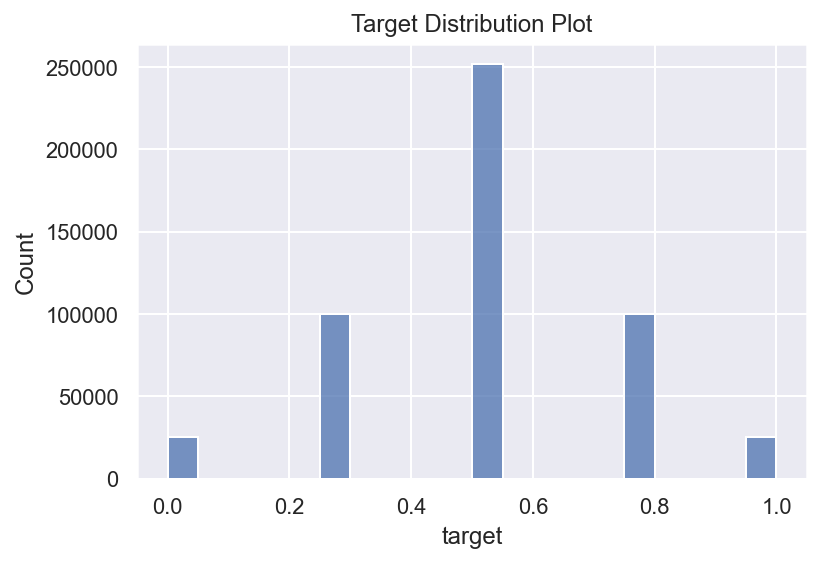

In [15]:
sns.set()
plt.title('Target Distribution Plot')
ax = sns.histplot(x=df.target)
plt.savefig(assets_dir / "target_distribution.png", format='png', dpi=1200, bbox_inches='tight')

### Unique features

In [16]:
nu = df.nunique().sort_values(ascending=False).reset_index()
print(nu)

                       index       0
0                         id  501808
1                        era     120
2          feature_strength7       5
3         feature_charisma86       5
4          feature_strength1       5
5          feature_strength2       5
6          feature_strength3       5
7          feature_strength4       5
8          feature_strength5       5
9          feature_strength6       5
10         feature_strength8       5
11        feature_charisma84       5
12         feature_strength9       5
13        feature_strength10       5
14        feature_strength11       5
15        feature_strength12       5
16        feature_strength13       5
17        feature_strength14       5
18        feature_strength15       5
19        feature_charisma85       5
20        feature_charisma83       5
21        feature_strength17       5
22        feature_charisma82       5
23        feature_charisma67       5
24        feature_charisma68       5
25        feature_charisma69       5
2

In [17]:
df.shape

(501808, 314)

In [18]:
df.data_type.unique()

array(['train'], dtype=object)

In [19]:
columns = [col for col in df.columns if "feature" in col]
values = set()
for col in columns:
    values.update(df[col].unique())
values

{0.0, 0.25, 0.5, 0.75, 1.0}

We have:
1. Unique Id = 501808
2. Descrite features 
3. data_type feature = "train"

### Distributions of the feautures

In [15]:
columns = [col for col in df.columns if "feature" in col]
len(columns)

310

In [ ]:
fig, axes = plt.subplots(ncols=5, nrows=62, figsize=(25, 100))
axes = axes.ravel()
for index, (feature, ax) in enumerate(zip(columns, axes)):
    ax.title.set_text(feature)
    sns.histplot(df[feature], ax=ax)

### Kruskal Wallis tests for the target and the features

In [ ]:
def split_categorial(df, col, target_col, groups=2):
    groups = min(groups, df[col].nunique())
    value_list = list(df[col].dropna().drop_duplicates().sample(
        n=groups, random_state=random_state))
    result_list = [df[df[col] == value_list[i]][target_col] for i in range(groups)]
    return result_list 

In [ ]:
cols = []
anova_verdict = []
kruskal_verdict = []
student_verdict = []
anova_values = []
kruskal_values = []
student_values = []

alpha = 0.05
inner_data = df.copy()

for col in columns:
    groups = split_categorial(
        inner_data.copy(), col, "target", groups=inner_data[col].nunique())
    if len(groups) < 2:
        continue
    kruskal_result = stats.kruskal(*groups)
    cols.append(col)
    kruskal_verdict.append(("No Significant difference" if kruskal_result.pvalue > alpha else "Significant difference"))
    kruskal_values.append(kruskal_result.pvalue)

tests_df = pd.DataFrame({
    "columns": cols, 
    "Kruskal Wallis": kruskal_verdict,
    "Kruskal Wallis p-value": kruskal_values
})
tests_df 

In [ ]:
tests_df.to_csv(submissions_dir / "kruskal_tests.csv", index=False)

### Principal Component Analysis(PCA)

In [32]:
def execute_pca(df, features, target_features):

    x_data = df[features]
    for target in target_features:
        if target in features:
            x_data = x_data.drop(target, axis=1)

    y_data = df[target_features]
    x_scaled = StandardScaler().fit_transform(x_data) 
    
    pca = PCA(n_components=2)
    principal_components = pca.fit_transform(x_scaled)
    principal_df = pd.DataFrame(
        data = principal_components, 
        columns = ['pca_component_1', 'pca_component_2']
    )
    final_df = pd.concat([principal_df, y_data], axis=1) 
    
    for target in target_features:
        targets = list(df[target].unique())
        legend = "auto" if final_df[target].nunique() <= 10 else False
        plt.figure(figsize=(10, 10))
        sns.scatterplot(
            final_df['pca_component_1'], 
            final_df['pca_component_2'], 
            hue=final_df[target],
            palette=sns.color_palette('tab10', n_colors=len(targets)),
            legend=legend
        )
        plt.savefig(assets_dir / f"pca_{target}.png", format='png', dpi=1200, bbox_inches='tight')

target
era


/Library/Python/3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Library/Python/3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


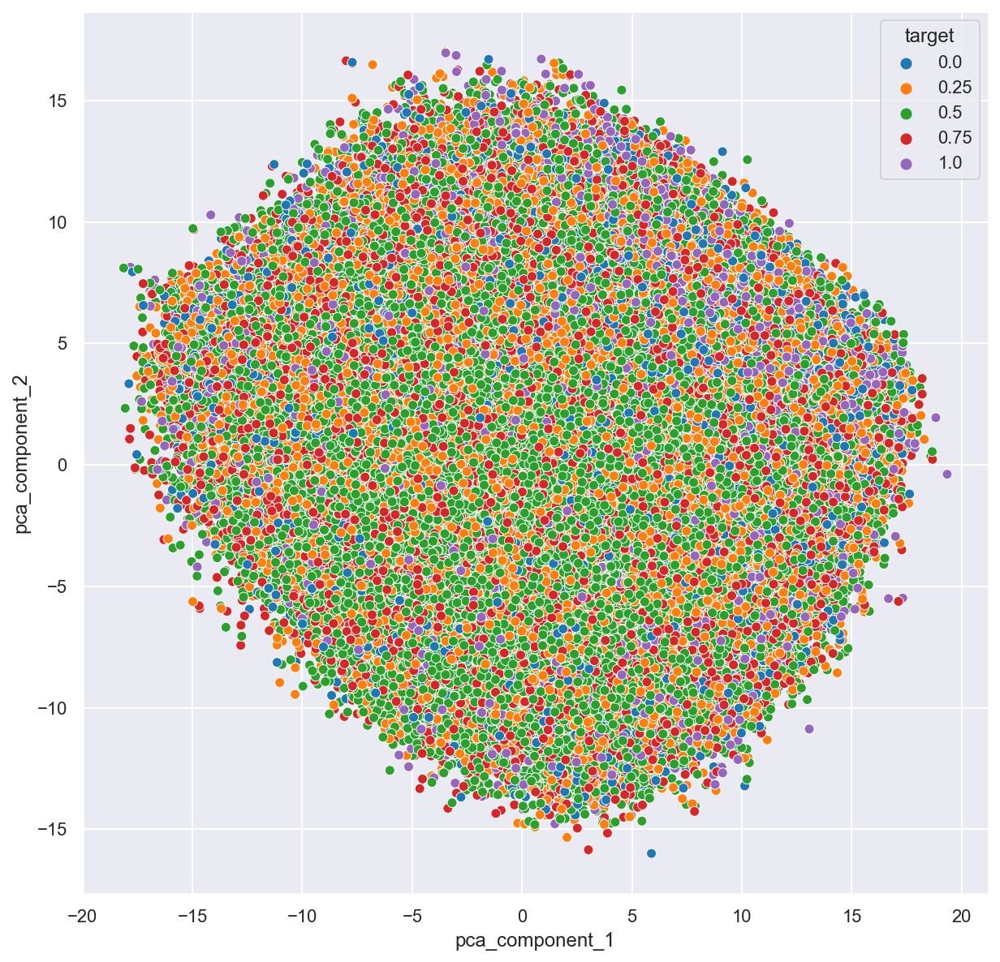

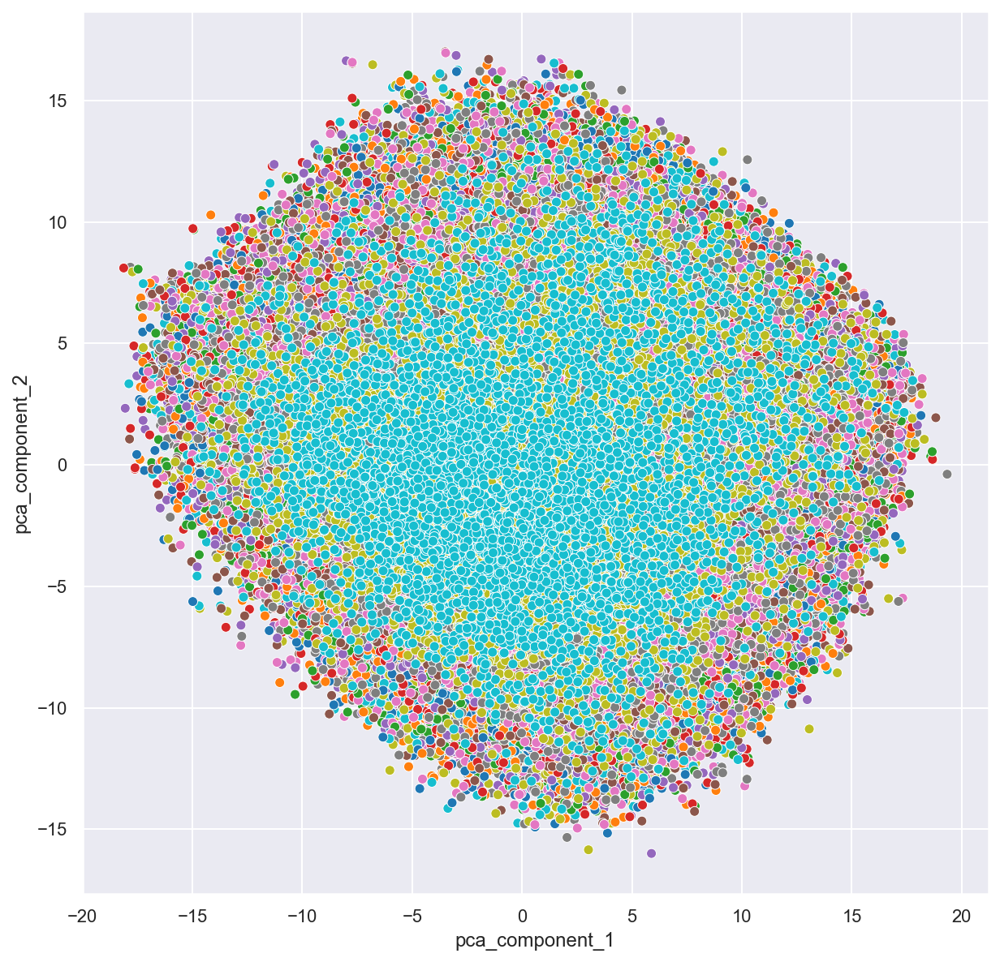

In [33]:
execute_pca(df, columns, ["target", "era"])

### t-distributed stochastic neighbor embedding(t-SNE)

In [19]:
def execute_tsne(df, features, target_features):
    x_data = df[features].copy()
    for target in target_features:
        if target in features:
            x_data = x_data.drop(target, axis=1)
    final_data = df
    
    tsne = TSNE(n_jobs=6, verbose=True)
    tsne_results = tsne.fit(x_data.values)
    final_data["tsne_component_1"] = tsne_results[:,0]
    final_data["tsne_component_2"] = tsne_results[:,1]
    return final_data

In [20]:
def plot_tsne(df, features, target_features):

    final_data = execute_tsne(df, features, target_features)
    
    for target in target_features:
        targets = list(df[target].unique())
        plt.figure(figsize=(20, 20))
        plt.title(target)
        legend = "auto" if df[target].nunique() <= 10 else False
        sns.scatterplot(
            x="tsne_component_1", y="tsne_component_2",
            hue=target,
            palette=sns.color_palette('tab10', n_colors=len(targets)),
            data=final_data,
            legend=legend
        )
        plt.savefig(assets_dir / f"tsne_{target}.png", format='png', dpi=1200, bbox_inches='tight')
        plt.show() 

--------------------------------------------------------------------------------
TSNE(n_jobs=6, verbose=True)
--------------------------------------------------------------------------------
===> Finding 90 nearest neighbors using Annoy approximate search using euclidean distance...
   --> Time elapsed: 340.79 seconds
===> Calculating affinity matrix...
   --> Time elapsed: 26.82 seconds
===> Calculating PCA-based initialization...
   --> Time elapsed: 14.21 seconds
===> Running optimization with exaggeration=12.00, lr=41817.33 for 250 iterations...
Iteration   50, KL divergence 9.1613, 50 iterations in 90.9518 sec
Iteration  100, KL divergence 8.9811, 50 iterations in 81.7893 sec
Iteration  150, KL divergence 8.9808, 50 iterations in 77.1947 sec
Iteration  200, KL divergence 8.9808, 50 iterations in 77.1937 sec
Iteration  250, KL divergence 8.9807, 50 iterations in 77.1100 sec
   --> Time elapsed: 404.24 seconds
===> Running optimization with exaggeration=1.00, lr=41817.33 for 500 ite

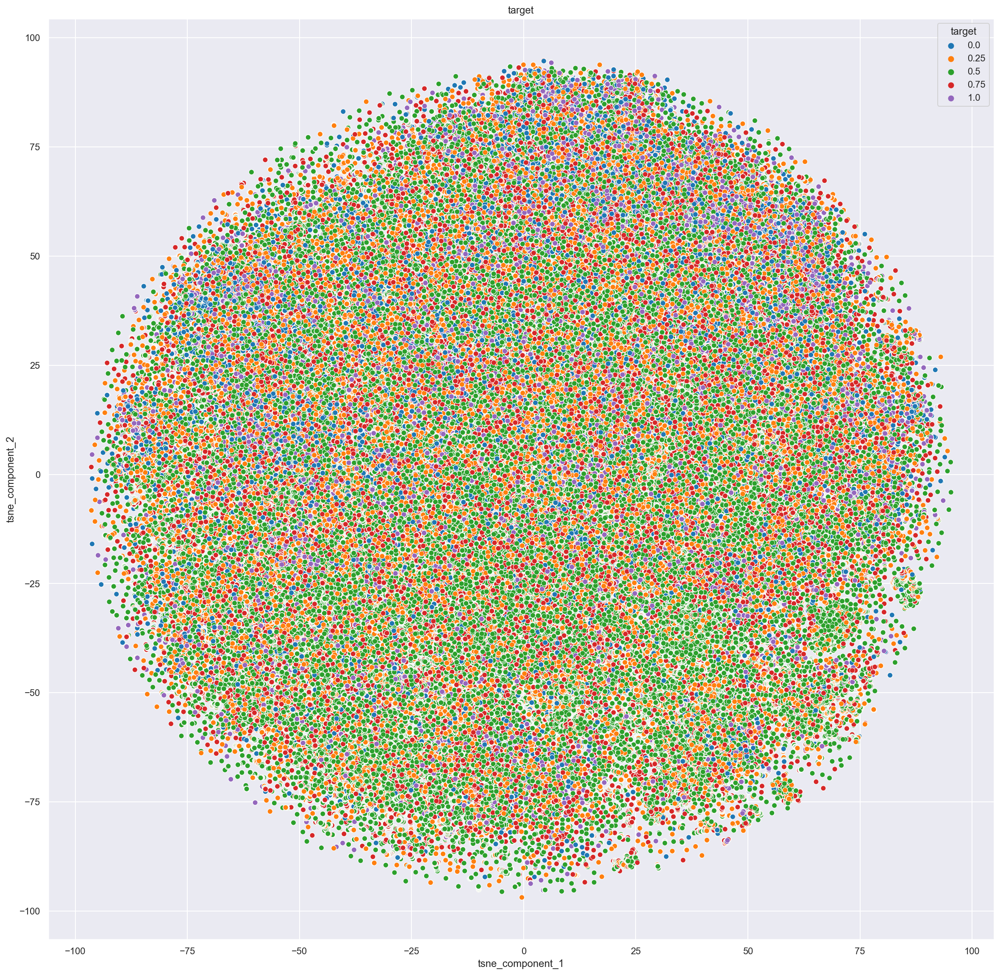

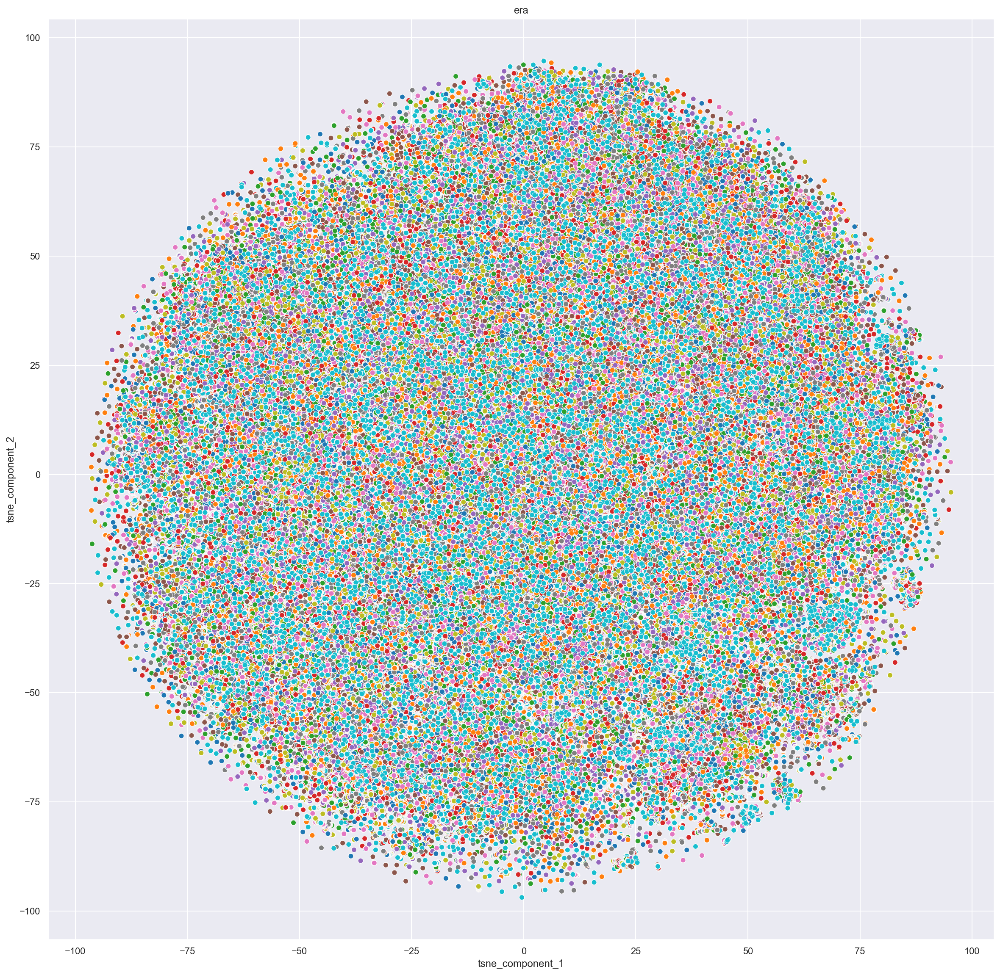

In [51]:
execute_tsne(df, columns, ["target", "era"])

### Clusterization analysis

In [21]:
final_data = execute_tsne(df, columns, ["target", "era"])

--------------------------------------------------------------------------------
TSNE(n_jobs=6, verbose=True)
--------------------------------------------------------------------------------
===> Finding 90 nearest neighbors using Annoy approximate search using euclidean distance...
   --> Time elapsed: 302.62 seconds
===> Calculating affinity matrix...
   --> Time elapsed: 28.78 seconds
===> Calculating PCA-based initialization...
   --> Time elapsed: 15.36 seconds
===> Running optimization with exaggeration=12.00, lr=41817.33 for 250 iterations...
Iteration   50, KL divergence 9.1613, 50 iterations in 96.1492 sec
Iteration  100, KL divergence 8.9811, 50 iterations in 88.2514 sec
Iteration  150, KL divergence 8.9807, 50 iterations in 86.9555 sec
Iteration  200, KL divergence 8.9807, 50 iterations in 86.9369 sec
Iteration  250, KL divergence 8.9807, 50 iterations in 84.9536 sec
   --> Time elapsed: 443.25 seconds
===> Running optimization with exaggeration=1.00, lr=41817.33 for 500 ite

In [ ]:
final_data.to_csv(states_dir / "tsne_features_state.csv", index=False)

In [17]:
def explore_eps_and_min_sample_values(data, k, should_scale=True):
    if should_scale:
        data = StandardScaler().fit_transform(data)
    nn = NearestNeighbors(n_neighbors=k).fit(data)
    distances, indices = nn.kneighbors(data)
    distances = np.sort(distances, axis=0)
    distances = distances[:,1]
    distances = distances[distances < 100]

    sns.set()
    plt.figure(figsize=(8, 8))
    plt.title(k)
    sns.lineplot(y=distances, x=range(distances.shape[0]), marker="o")  
    plt.savefig(assets_dir / f"dbscan_eps.png", format='png', dpi=1200, bbox_inches='tight')

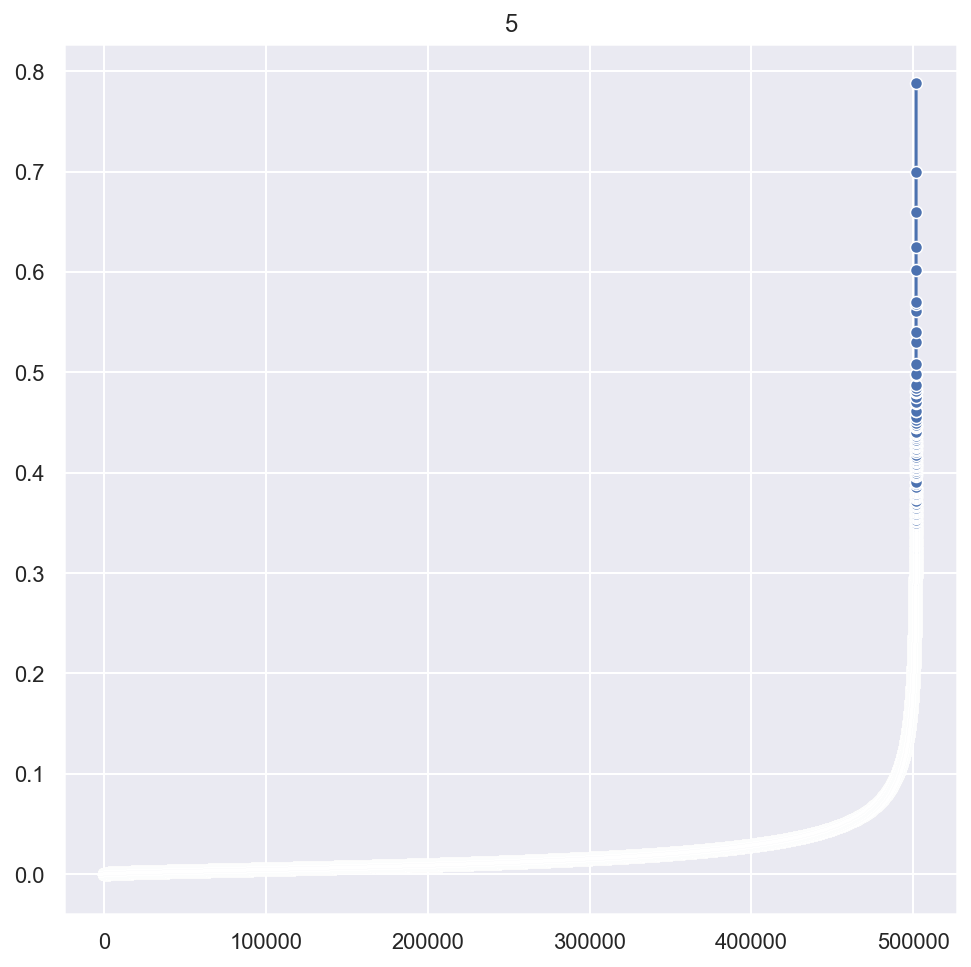

In [19]:
explore_eps_and_min_sample_values(final_data[["tsne_component_1", "tsne_component_2"]], 5, should_scale=False) 